# Data pre processing and cleaning

In [1]:
import glob
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

In [2]:
# helper function for data visualization
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()
    
# helper function for data visualization    
def denormalize(x):
    """Scale image to range 0..1 for correct plot"""
    x_max = np.percentile(x, 98)
    x_min = np.percentile(x, 2)    
    x = (x - x_min) / (x_max - x_min)
    x = x.clip(0, 1)
    return x

## Removing files where either input or corresponding output file is missing and then splitting each image and corresponding label into 4.

In [87]:
train_inputs = glob.glob('training/input/*.png')
train_inputs = [name.split('/')[-1] for name in train_inputs]
train_outputs = glob.glob('training/output/*.png')
train_outputs = [name.split('/')[-1] for name in train_outputs]

In [102]:
# making sure we only pick the files for which we have both input and output availaable.
train_file_names = []
for name in train_outputs:
    if name in train_inputs:
        train_file_names.append(name)

In [103]:
len(train_file_names)

804

In [92]:
test_file_names = glob.glob('testing/input/*.png')
test_file_names = [name.split('/')[-1] for name in test_file_names]

In [104]:
test_file_names

['img-3.png',
 'img-2.png',
 'img-1.png',
 'img-5.png',
 'img-4.png',
 'img-6.png',
 'img-7.png',
 'img-9.png',
 'img-8.png',
 'img-13.png',
 'img-12.png',
 'img-10.png',
 'img-11.png']

In [94]:
def split_image_into_four(img):
    img_a = img[0:750, 0:750, :]
    img_b = img[750:1500, 0:750, :]
    img_c = img[0:750, 750:1500, :]
    img_d = img[750:1500, 750:1500, :]
    return [img_a, img_b, img_c, img_d]

In [95]:
def save_four_splits(img, img_name, save_path):
    img_splits = split_image_into_four(img)
    splits = ['a', 'b', 'c', 'd']
    for i in range(len(splits)):
        cv2.imwrite(save_path + img_name[:-4] + splits[i] + '.png', img_splits[i])

In [96]:
def split_and_save_train_images(img_name):
    input_path = 'training/input/'
    output_path = 'training/output/'
    input_orig = cv2.imread(input_path + img_name)
    output_orig = cv2.imread(output_path + img_name)
    save_four_splits(input_orig, img_name, 'data/training/input/')
    save_four_splits(output_orig, img_name, 'data/training/output/')

In [101]:
def split_and_save_test_images(img_name):
    input_path = 'testing/input/'
    output_path = 'testing/output/'
    input_orig = cv2.imread(input_path + img_name)
    output_orig = cv2.imread(output_path + img_name)
    save_four_splits(input_orig, img_name, 'data/testing/input/')
    save_four_splits(output_orig, img_name, 'data/testing/output/')

In [99]:
# for file_name in tqdm(train_file_names):
#     split_and_save_train_images(file_name)

100%|██████████| 804/804 [02:33<00:00,  5.25it/s]


In [105]:
# for file_name in tqdm(test_file_names):
#     split_and_save_test_images(file_name)

100%|██████████| 13/13 [00:02<00:00,  5.14it/s]


In [21]:
input_image_paths = glob.glob('data/training/input/*.png')

### Filtering out the corrupt files names, where some images have missing satellite image but have a corresponding label

In [23]:
corrupt_files = []
for img_path in tqdm(input_image_paths):
    img = cv2.imread(img_path)
    arr = np.amax(img, axis = -1)
    count = np.count_nonzero(arr == 255)
    if count > 5000:
        corrupt_files.append(img_path)

100%|██████████| 3216/3216 [01:12<00:00, 44.63it/s]


In [3]:
# corrupt_files

In [36]:
corrupt_labels = [file_name.replace('input', 'output') for file_name in corrupt_files]

### LETS VISUALIZE AND SEE THE CORRUPT IMAGES AND LABELS

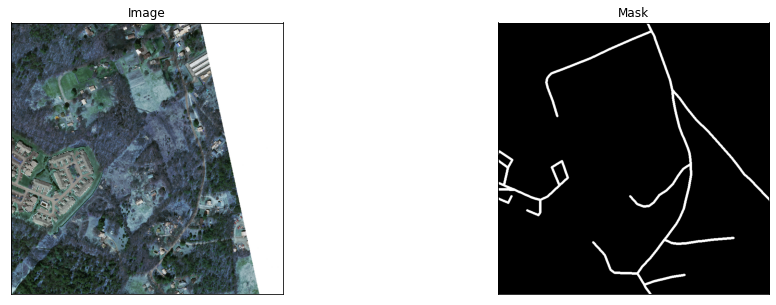

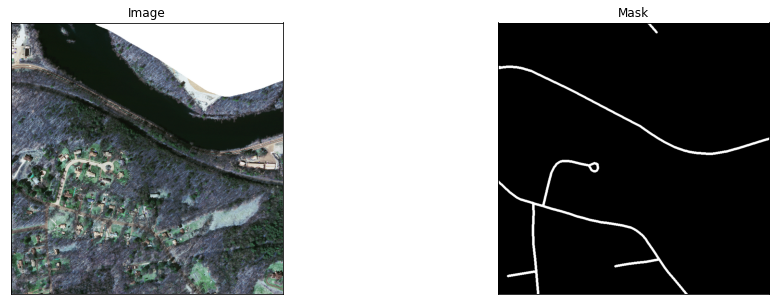

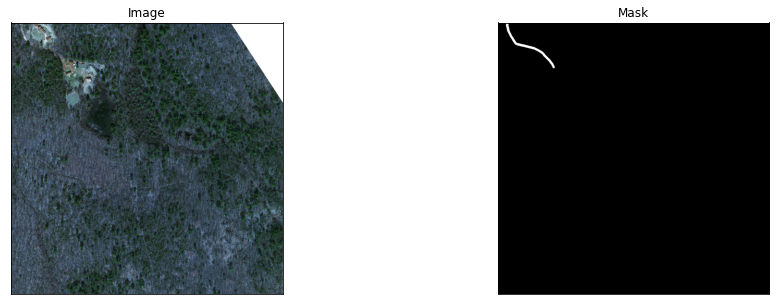

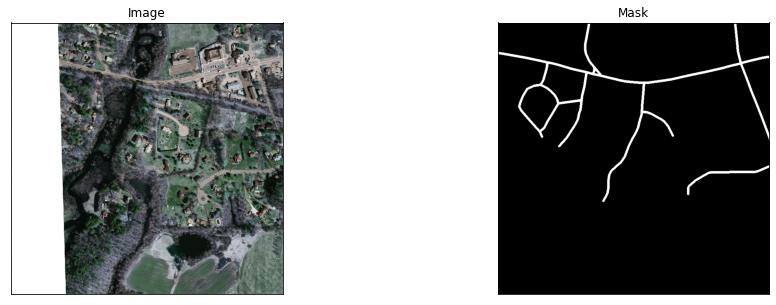

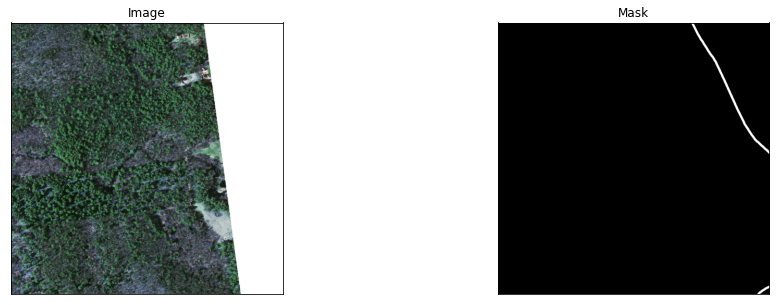

...

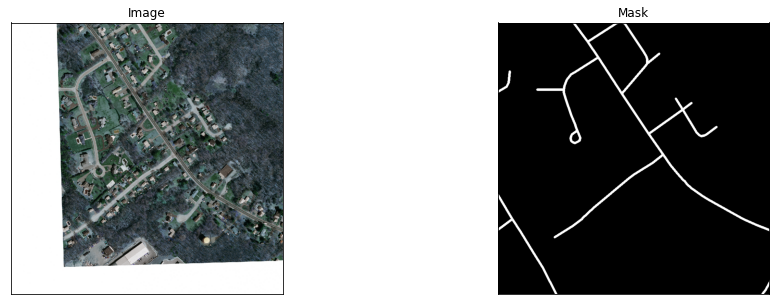

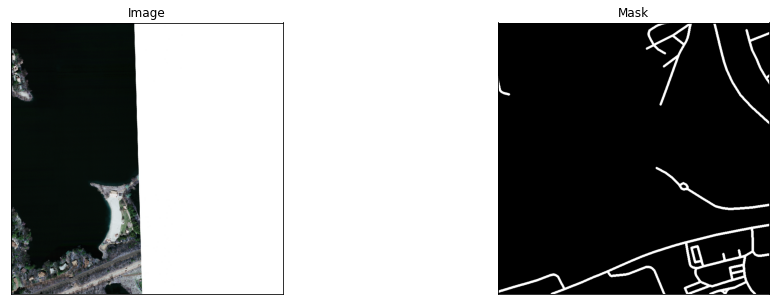

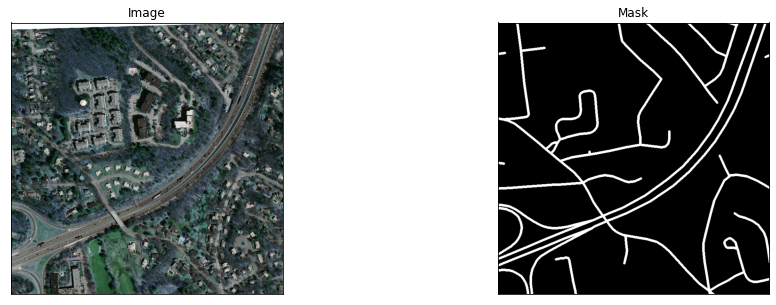

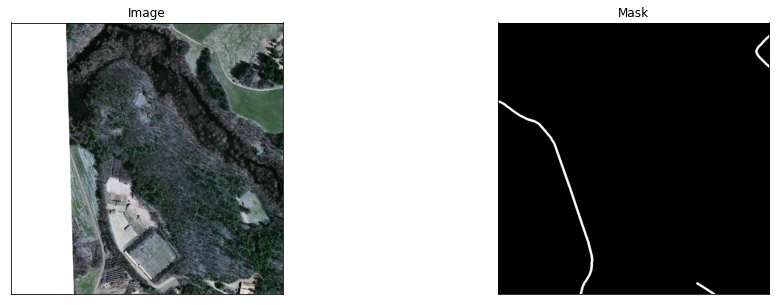

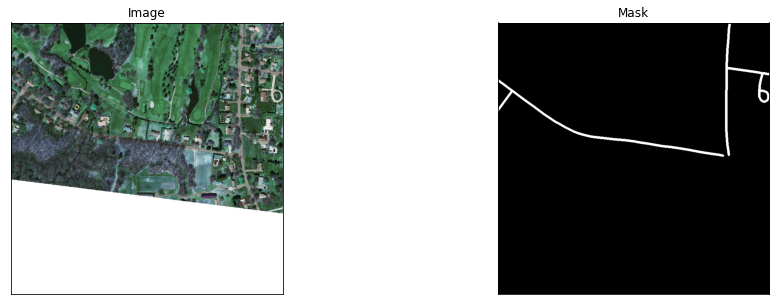

In [40]:
for i in range(len(corrupt_files)):
    img = cv2.imread(corrupt_files[i])
    mask = cv2.imread(corrupt_labels[i])
    visualize(image = img,
             mask = mask)

### Removing all corrupt files

In [43]:
for i in range(len(corrupt_files)):
    if os.path.exists(corrupt_files[i]):
        os.remove(corrupt_files[i])
    if os.path.exists(corrupt_labels[i]):
        os.remove(corrupt_labels[i])    

In [44]:
!ls data/training/input/ | wc -l

    3021


In [45]:
!ls data/training/output/ | wc -l

    3021
